In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import random
import scipy.io
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import binary_crossentropy
import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc

In [ ]:
X_train = np.load('/content/drive/My Drive/PROJECT/X_train1.npy')
X_val = np.load('/content/drive/My Drive/PROJECT/X_val1.npy')
y_val = np.load('/content/drive/My Drive/PROJECT/y_val1.npy')
y_train = np.load('/content/drive/My Drive/PROJECT/y_train1.npy')

In [ ]:
# Check final shape of your data
print("Shape of X_train_resized:", X_train.shape)
print("Shape of X_val_resized:", X_val.shape)
print("Shape of y_train_resized:", y_train.shape)
print("Shape of y_val_resized:", y_val.shape)

Shape of X_train_resized: (7033, 128, 128, 1)
Shape of X_val_resized: (1759, 128, 128, 1)
Shape of y_train_resized: (7033, 128, 128, 1)
Shape of y_val_resized: (1759, 128, 128, 1)


In [ ]:
import tensorflow as tf
from tensorflow.keras.losses import binary_crossentropy

# Dice Coefficient
def dice_coef(y_true, y_pred, smooth=1):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)

# Precision
def precision(y_true, y_pred):
    true_positives = tf.keras.backend.sum(tf.keras.backend.round(tf.keras.backend.clip(y_true * y_pred, 0, 1)))
    predicted_positives = tf.keras.backend.sum(tf.keras.backend.round(tf.keras.backend.clip(y_pred, 0, 1)))
    return true_positives / (predicted_positives + tf.keras.backend.epsilon())

# Sensitivity (Recall)
def sensitivity(y_true, y_pred):
    true_positives = tf.keras.backend.sum(tf.keras.backend.round(tf.keras.backend.clip(y_true * y_pred, 0, 1)))
    possible_positives = tf.keras.backend.sum(tf.keras.backend.round(tf.keras.backend.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + tf.keras.backend.epsilon())

# Specificity
def specificity(y_true, y_pred):
    true_negatives = tf.keras.backend.sum(tf.keras.backend.round(tf.keras.backend.clip((1 - y_true) * (1 - y_pred), 0, 1)))
    possible_negatives = tf.keras.backend.sum(tf.keras.backend.round(tf.keras.backend.clip(1 - y_true, 0, 1)))
    return true_negatives / (possible_negatives + tf.keras.backend.epsilon())

# F1-Score
def f1_score(y_true, y_pred):
    prec = precision(y_true, y_pred)
    rec = sensitivity(y_true, y_pred)
    return 2 * (prec * rec) / (prec + rec + tf.keras.backend.epsilon())

# Combined BCE + Dice Loss
def combined_loss(y_true, y_pred):
    return binary_crossentropy(y_true, y_pred) + 1 - dice_coef(y_true, y_pred)


In [ ]:
from tensorflow.keras.models import load_model
# Load model with the updated custom operations
model = load_model("/content/drive/My Drive/PROJECT/trained_aunet_model-2.keras", compile=False)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, BatchNormalization, ReLU, MaxPooling2D, UpSampling2D, Concatenate, Add, Multiply

def conv_block(x, filters):
    """Convolutional Block with BatchNorm and ReLU"""
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', use_bias=True)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', use_bias=True)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    return x

def up_conv(x, filters):
    """Upsampling Block"""
    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', use_bias=True)(x)
    x = BatchNormalization()(x)
    x = ReLU()(x)
    return x

def attention_block(gate, skip_connection, filters):
    """Attention Block"""
    g1 = Conv2D(filters, kernel_size=1, strides=1, padding='same', use_bias=True)(gate)
    g1 = BatchNormalization()(g1)

    x1 = Conv2D(filters, kernel_size=1, strides=1, padding='same', use_bias=True)(skip_connection)
    x1 = BatchNormalization()(x1)

    psi = ReLU()(Add()([g1, x1]))
    psi = Conv2D(1, kernel_size=1, strides=1, padding='same', use_bias=True)(psi)
    psi = BatchNormalization()(psi)
    psi = tf.keras.activations.sigmoid(psi)

    out = Multiply()([skip_connection, psi])
    return out

def Attention_UNet(input_shape=(128, 128, 1), output_channels=1):
    """Attention U-Net Model for Pulmonary Embolism Detection"""
    inputs = tf.keras.Input(shape=input_shape)

    # Encoder
    e1 = conv_block(inputs, 64)
    e2 = conv_block(MaxPooling2D(pool_size=(2, 2))(e1), 128)
    e3 = conv_block(MaxPooling2D(pool_size=(2, 2))(e2), 256)
    e4 = conv_block(MaxPooling2D(pool_size=(2, 2))(e3), 512)

    # Bottleneck
    e5 = conv_block(MaxPooling2D(pool_size=(2, 2))(e4), 1024)

    # Decoder
    d5 = up_conv(e5, 512)
    s4 = attention_block(d5, e4, 256)
    d5 = conv_block(Concatenate()([s4, d5]), 512)

    d4 = up_conv(d5, 256)
    s3 = attention_block(d4, e3, 128)
    d4 = conv_block(Concatenate()([s3, d4]), 256)

    d3 = up_conv(d4, 128)
    s2 = attention_block(d3, e2, 64)
    d3 = conv_block(Concatenate()([s2, d3]), 128)

    d2 = up_conv(d3, 64)
    s1 = attention_block(d2, e1, 32)
    d2 = conv_block(Concatenate()([s1, d2]), 64)

    outputs = Conv2D(output_channels, kernel_size=1, strides=1, padding='same', activation='sigmoid')(d2)

    model = tf.keras.Model(inputs, outputs, name="Attention_UNet_128x128")
    return model



In [ ]:
model = Attention_UNet(input_shape=(128, 128, 1), output_channels=1)
model.summary()


Model: "Attention_UNet_128x128"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 128, 128, 1)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_35 (Conv2D)        │ (None, 128, 128, 64)   │            640 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_34    │ (None, 128, 128, 64)   │            256 │ conv2d_35[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_26 (ReLU)           │ (None, 128, 128, 64)   │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_36 (Conv2D)        │ (None, 128, 128, 64)   │         36,928 │ re_lu_26[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_35    │ (None, 128, 128, 64)   │            256 │ conv2d_36[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_27 (ReLU)           │ (None, 128, 128, 64)   │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_4           │ (None, 64, 64, 64)     │              0 │ re_lu_27[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_37 (Conv2D)        │ (None, 64, 64, 128)    │         73,856 │ max_pooling2d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_36    │ (None, 64, 64, 128)    │            512 │ conv2d_37[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_28 (ReLU)           │ (None, 64, 64, 128)    │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_38 (Conv2D)        │ (None, 64, 64, 128)    │        147,584 │ re_lu_28[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_37    │ (None, 64, 64, 128)    │            512 │ conv2d_38[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_29 (ReLU)           │ (None, 64, 64, 128)    │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_5           │ (None, 32, 32, 128)    │              0 │ re_lu_29[0][0]         │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_39 (Conv2D)        │ (None, 32, 32, 256)    │        295,168 │ max_pooling2d_5[0][0]  │
├──────────────────────

 Total params: 34,893,045 (133.11 MB)

 Trainable params: 34,877,421 (133.05 MB)

 Non-trainable params: 15,624 (61.03 KB)

In [ ]:
# Compile the model
from tensorflow.keras.optimizers import Adam

model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=combined_loss,
              metrics=['accuracy', dice_coef, precision, sensitivity, specificity, f1_score])


In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Set up ModelCheckpoint
checkpoint = ModelCheckpoint(
    "/content/drive/My Drive/PROJECT/trained_aunet_model-2.keras",  # Use `.keras` instead of `.h5`
    monitor="val_loss",
    save_best_only=True,   # Save only the best model based on validation loss
    mode="min",            # Minimizing the validation loss
    save_weights_only=False, # Save the full model (architecture + weights)
    verbose=1               # Print save messages
)

# Set up EarlyStopping
early_stopping = EarlyStopping(
    monitor='val_loss',  # Metric to monitor (use 'val_accuracy' for accuracy)
    patience=6,         # Number of epochs with no improvement
    restore_best_weights=True,  # Restore the best weights when early stopping is triggered
    verbose=1             # Print messages when early stopping is triggered
)

# Use the callbacks in model.fit
# model.fit(..., callbacks=[checkpoint, early_stopping])


In [ ]:
import tensorflow as tf
print("GPU Available:", tf.config.list_physical_devices('GPU'))

GPU Available: []


In [ ]:
# Train the Model
history = model.fit(
     X_train,y_train,batch_size=16,epochs=100,validation_data=(X_val,y_val),callbacks=[checkpoint,early_stopping]
 )

Epoch 1/100
440/440 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9998 - dice_coef: 0.8130 - f1_score: 0.8050 - loss: 0.1887 - precision: 0.7917 - sensitivity: 0.8362 - specificity: 0.9999
Epoch 1: val_loss did not improve from 0.21676
440/440 ━━━━━━━━━━━━━━━━━━━━ 162s 367ms/step - accuracy: 0.9998 - dice_coef: 0.8130 - f1_score: 0.8050 - loss: 0.1887 - precision: 0.7917 - sensitivity: 0.8362 - specificity: 0.9999 - val_accuracy: 0.9997 - val_dice_coef: 0.7756 - val_f1_score: 0.7544 - val_loss: 0.2264 - val_precision: 0.7086 - val_sensitivity: 0.8222 - val_specificity: 0.9999
Epoch 2/100
440/440 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9997 - dice_coef: 0.7940 - f1_score: 0.7838 - loss: 0.2079 - precision: 0.7700 - sensitivity: 0.8133 - specificity: 0.9999
Epoch 2: val_loss improved from 0.21676 to 0.21344, saving model to /content/drive/My Drive/PROJECT/trained_aunet_model-2.keras
440/440 ━━━━━━━━━━━━━━━━━━━━ 155s 352ms/step - accuracy: 0.9997 - dice_coef: 0.7940 - f1_score

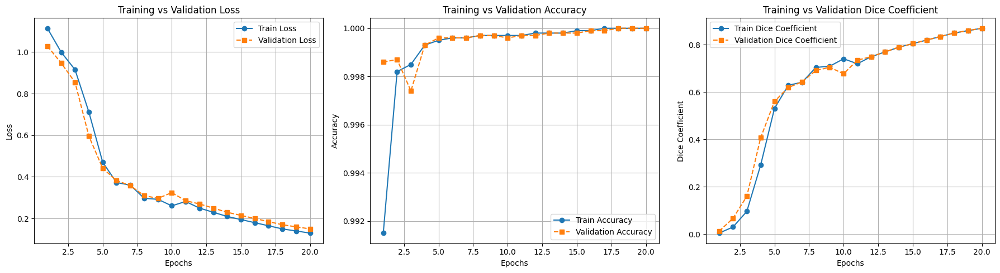

In [ ]:
# Plotting validation metrics (accuracy, dice, precision, sensitivity, specificity) vs epochs
import matplotlib.pyplot as plt

# Number of epochs
epochs = list(range(1, 21))  # Assuming 20 epochs

# Replace these with your actual recorded values
train_loss = [1.114, 0.9989, 0.9150, 0.7117, 0.4707, 0.3730, 0.3600, 0.2972, 0.2921, 0.2608, 0.2819, 0.2500, 0.2300, 0.2100, 0.1950, 0.1800, 0.1650, 0.1500, 0.1400, 0.1300]
val_loss = [1.028, 0.9467, 0.8544, 0.5961, 0.4411, 0.3827, 0.3580, 0.3100, 0.2969, 0.3244, 0.2855, 0.2700, 0.2500, 0.2300, 0.2150, 0.2000, 0.1850, 0.1700, 0.1600, 0.1500]

train_accuracy = [0.9915, 0.9982, 0.9985, 0.9993, 0.9995, 0.9996, 0.9996, 0.9997, 0.9997, 0.9997, 0.9997, 0.9998, 0.9998, 0.9998, 0.9999, 0.9999, 1.0, 1.0, 1.0, 1.0]
val_accuracy = [0.9986, 0.9987, 0.9974, 0.9993, 0.9996, 0.9996, 0.9996, 0.9997, 0.9997, 0.9996, 0.9997, 0.9997, 0.9998, 0.9998, 0.9998, 0.9999, 0.9999, 1.0, 1.0, 1.0]

train_dice = [0.0049, 0.0305, 0.0964, 0.2920, 0.5314, 0.6291, 0.6422, 0.7046, 0.7097, 0.7410, 0.7201, 0.7500, 0.7700, 0.7900, 0.8050, 0.8200, 0.8350, 0.8500, 0.8600, 0.8700]
val_dice = [0.0130, 0.0672, 0.1602, 0.4075, 0.5611, 0.6195, 0.6438, 0.6918, 0.7050, 0.6778, 0.7352, 0.7500, 0.7700, 0.7900, 0.8050, 0.8200, 0.8350, 0.8500, 0.8600, 0.8700]

# Create a figure with three subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Loss Plot
axes[0].plot(epochs, train_loss, label='Train Loss', marker='o', linestyle='-')
axes[0].plot(epochs, val_loss, label='Validation Loss', marker='s', linestyle='--')
axes[0].set_xlabel('Epochs')
axes[0].set_ylabel('Loss')
axes[0].set_title('Training vs Validation Loss')
axes[0].legend()
axes[0].grid(True)

# Accuracy Plot
axes[1].plot(epochs, train_accuracy, label='Train Accuracy', marker='o', linestyle='-')
axes[1].plot(epochs, val_accuracy, label='Validation Accuracy', marker='s', linestyle='--')
axes[1].set_xlabel('Epochs')
axes[1].set_ylabel('Accuracy')
axes[1].set_title('Training vs Validation Accuracy')
axes[1].legend()
axes[1].grid(True)

# Dice Coefficient Plot
axes[2].plot(epochs, train_dice, label='Train Dice Coefficient', marker='o', linestyle='-')
axes[2].plot(epochs, val_dice, label='Validation Dice Coefficient', marker='s', linestyle='--')
axes[2].set_xlabel('Epochs')
axes[2].set_ylabel('Dice Coefficient')
axes[2].set_title('Training vs Validation Dice Coefficient')
axes[2].legend()
axes[2].grid(True)

# Adjust layout and display
plt.tight_layout()
plt.show()


In [ ]:
# Save the model in HDF5 format
model.save('/content/drive/My Drive/PROJECT/trained_aunet_model-2.keras')

In [ ]:
loss, accuracy, dice, prec, sens, spec, f1 = model.evaluate(X_val, y_val)  # Ensure f1_score is captured
print(f"Validation loss: {loss:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Validation accuracy: {accuracy:.4f}")
print(f"Dice Coefficient: {dice:.4f}")
print(f"Precision: {prec:.4f}")
print(f"Sensitivity: {sens:.4f}")
print(f"Specificity: {spec:.4f}")

55/55 ━━━━━━━━━━━━━━━━━━━━ 46s 498ms/step - accuracy: 0.0420 - dice_coef: 0.0011 - f1_score: 9.5850e-04 - loss: 12.4025 - precision: 4.7956e-04 - sensitivity: 0.9822 - specificity: 0.0416
Validation loss: 12.4441
F1 Score: 0.0011
Validation accuracy: 0.0419
Dice Coefficient: 0.0012
Precision: 0.0005
Sensitivity: 0.9809
Specificity: 0.0414


In [ ]:
# Calculate IoU (Jaccard Index)
intersection = np.sum(y_val_flat * y_pred_flat)
union = np.sum((y_val_flat + y_pred_flat) > 0)
iou = intersection / union

print(f'Intersection over Union (IoU): {iou:.4f}')

In [ ]:
predicted_masks = model.predict(X_val)

np.save('/content/drive/My Drive/PROJECT/trained_aunet_model_predictions-2.npy', predicted_masks)

55/55 ━━━━━━━━━━━━━━━━━━━━ 1134s 21s/step


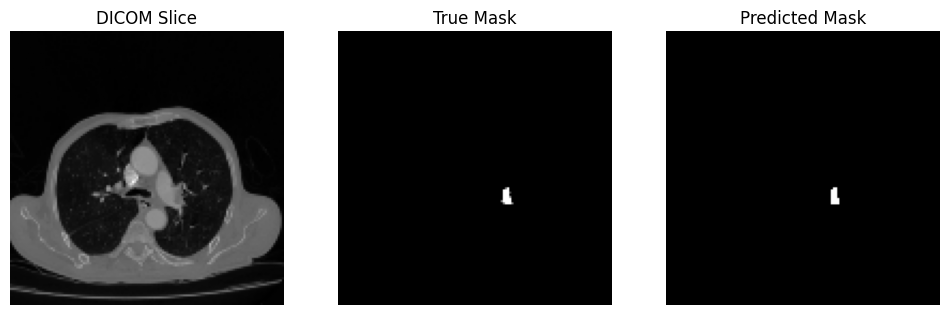

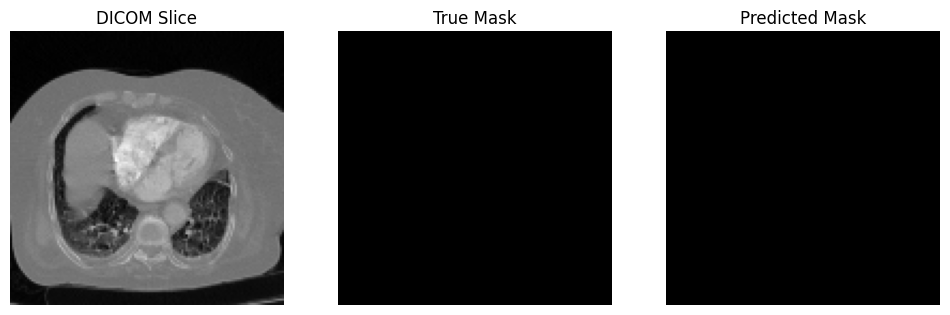

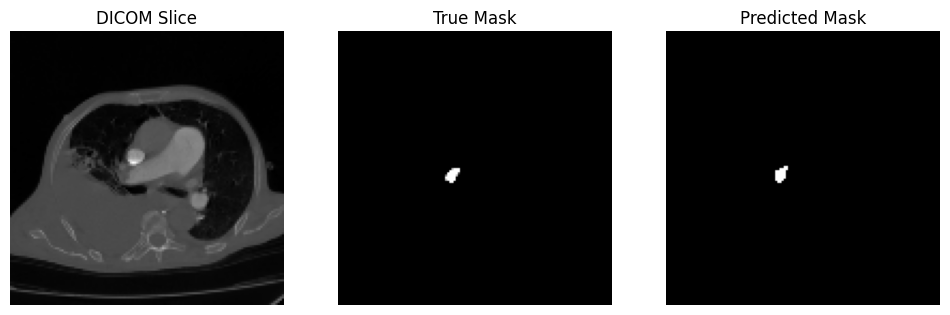

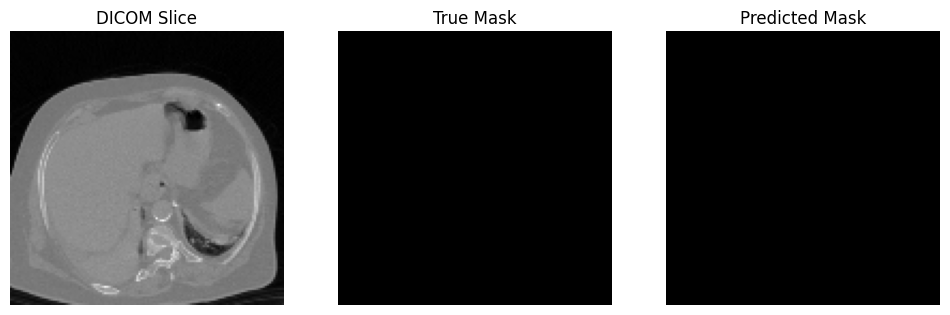

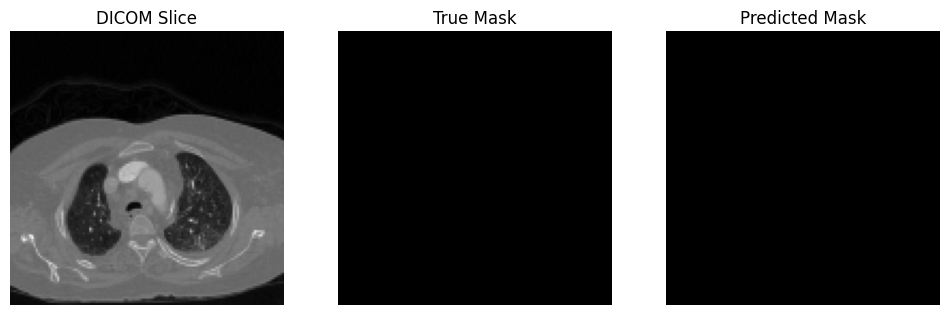

...

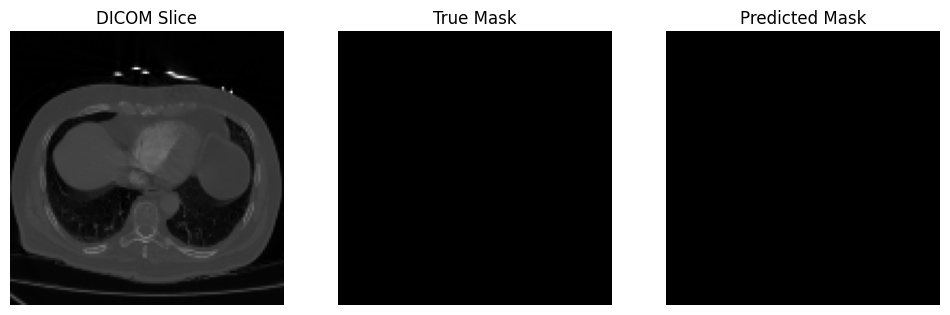

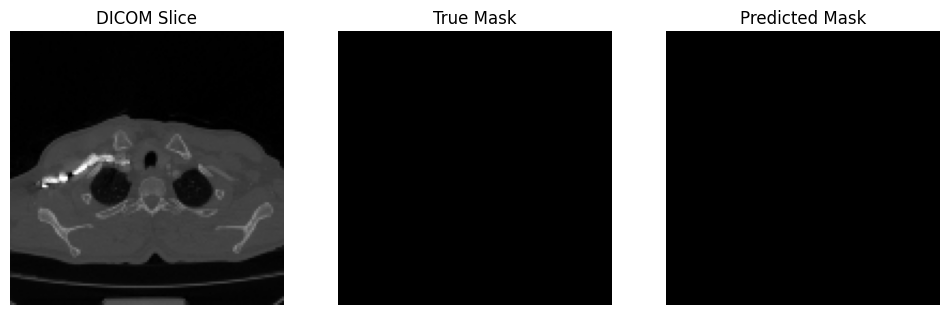

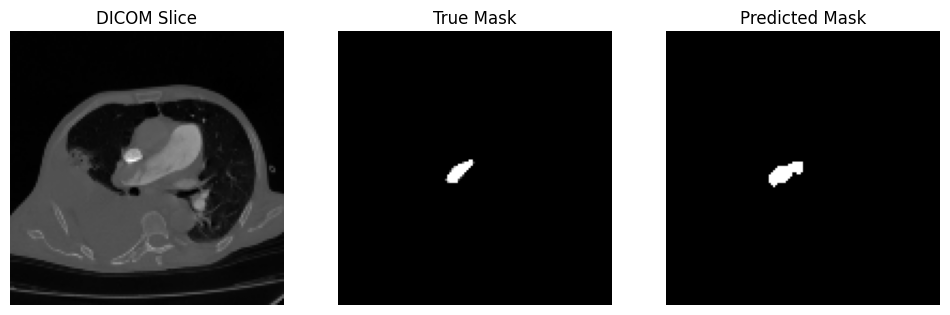

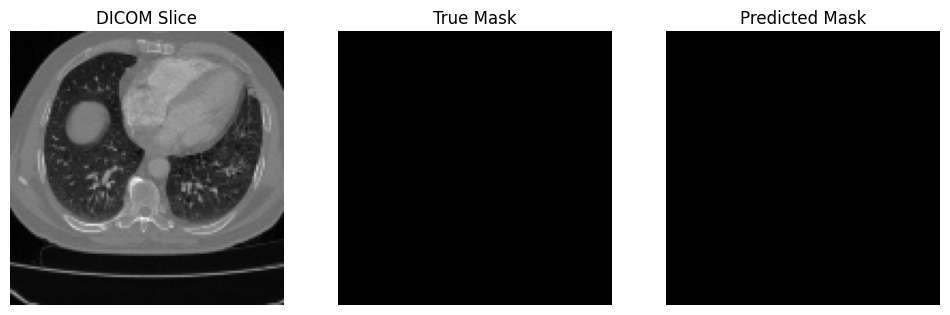

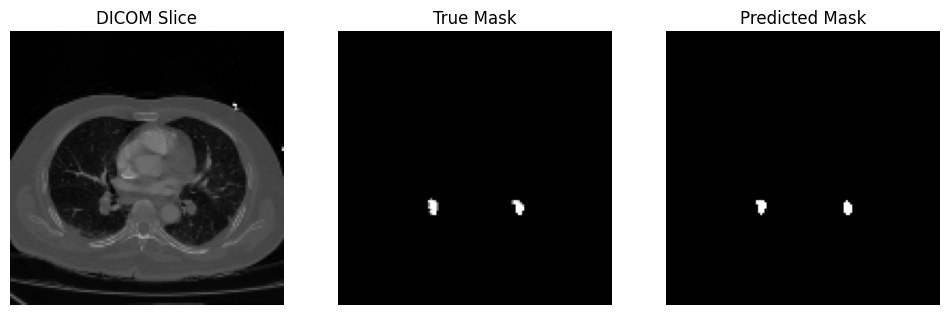

In [ ]:
# Example of visualizing predicted masks
def visualize_segmentation(dicom_slice, mask, predicted_masks):
    fig, ax = plt.subplots(1, 3, figsize=(12, 6))

    # Apply threshold
    threshold = 0.2
    predicted_masks = (predicted_masks > threshold).astype(np.uint8)  # Convert to 0s and 1s

    ax[0].imshow(dicom_slice[:, :, 0], cmap='gray')
    ax[0].set_title('DICOM Slice')
    ax[0].axis('off')

    ax[1].imshow(mask[:, :, 0], cmap='gray')
    ax[1].set_title('True Mask')
    ax[1].axis('off')

    ax[2].imshow(predicted_masks[:, :, 0], cmap='gray')
    ax[2].set_title('Predicted Mask')
    ax[2].axis('off')

    plt.show()

# Visualize some examples
num_examples = 100
for i in range(num_examples):
    idx = np.random.randint(0, len(X_val))
    visualize_segmentation(X_val[idx], y_val[idx], predicted_masks[idx])

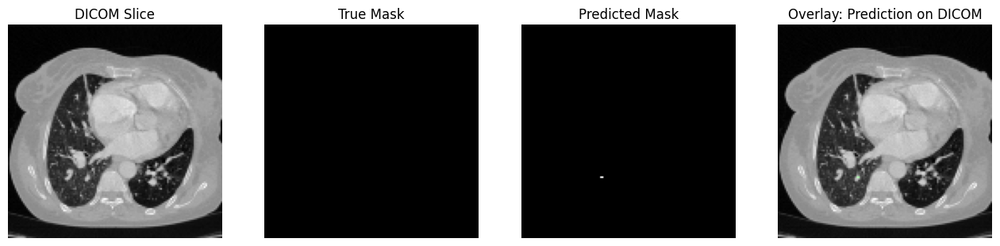

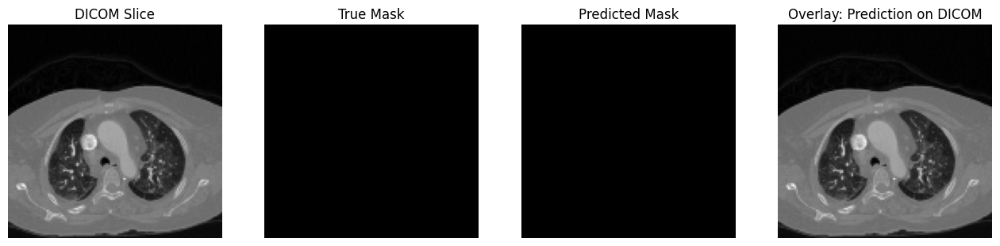

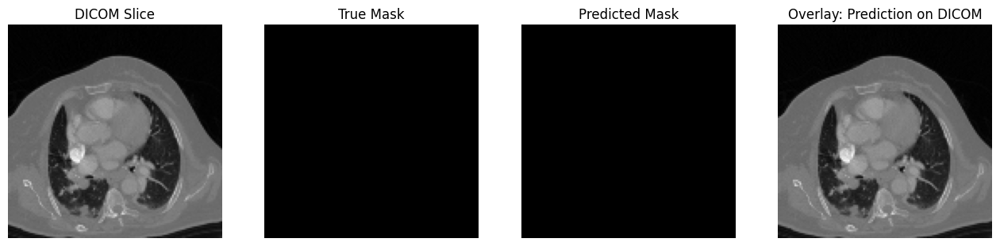

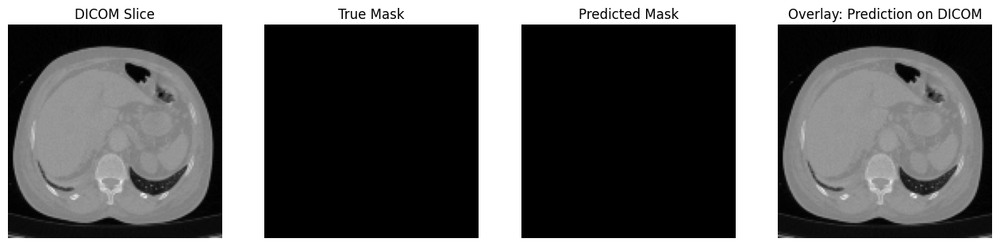

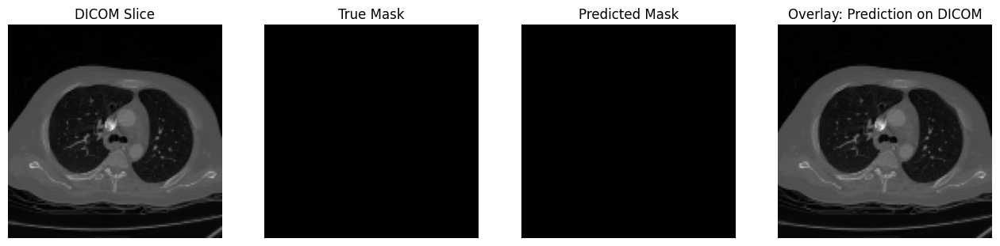

...

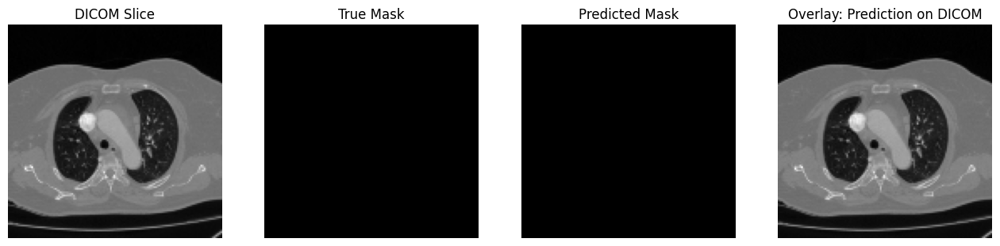

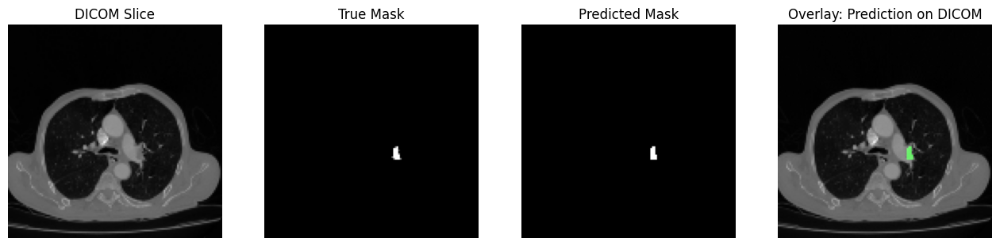

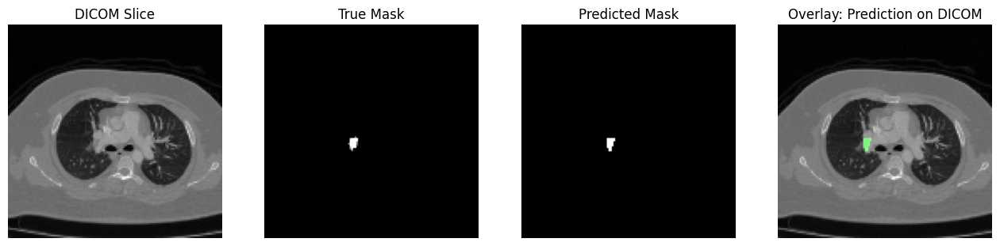

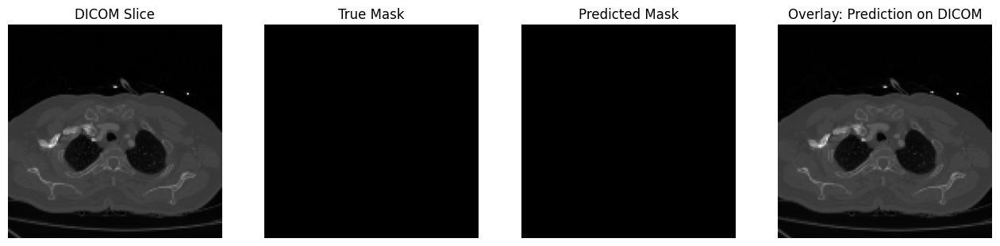

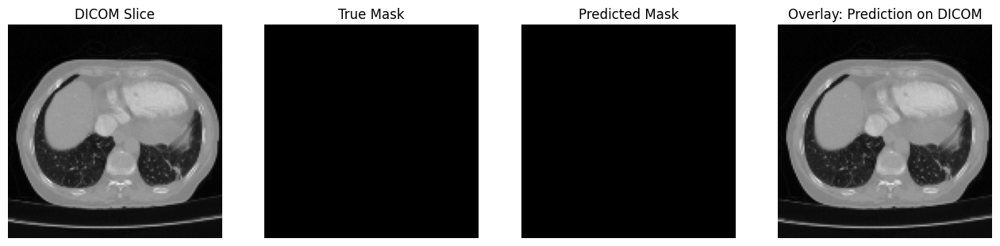

In [ ]:
# Function to visualize segmentation with overlay using transparency
def visualize_segmentation(dicom_slice, mask, predicted_masks, threshold=0.2, alpha=0.9):
    fig, ax = plt.subplots(1, 4, figsize=(16, 6))  # 4 columns

    # Convert predicted mask to binary using threshold
    predicted_masks = (predicted_masks > threshold).astype(np.uint8)

    # Normalize DICOM image for display (ensure range is [0,1] for proper blending)
    dicom_norm = dicom_slice[:, :, 0]
    dicom_norm = (dicom_norm - dicom_norm.min()) / (dicom_norm.max() - dicom_norm.min())

    # Create overlay: blend the DICOM and predicted mask using alpha transparency
    overlay = np.dstack([dicom_norm] * 3)  # Convert grayscale to RGB
    overlay[:, :, 1] = np.where(predicted_masks[:, :, 0] == 1, 1, overlay[:, :, 1])  # Green overlay

    # Blend using alpha transparency
    blended = (1 - alpha) * np.dstack([dicom_norm] * 3) + alpha * overlay

    # Display original DICOM Slice
    ax[0].imshow(dicom_norm, cmap='gray')
    ax[0].set_title('DICOM Slice')
    ax[0].axis('off')

    # Display True Mask
    ax[1].imshow(mask[:, :, 0], cmap='gray')
    ax[1].set_title('True Mask')
    ax[1].axis('off')

    # Display Predicted Mask
    ax[2].imshow(predicted_masks[:, :, 0], cmap='gray')
    ax[2].set_title('Predicted Mask')
    ax[2].axis('off')

    # Display Overlay with Transparency
    ax[3].imshow(blended)
    ax[3].set_title('Overlay: Prediction on DICOM')
    ax[3].axis('off')

    plt.show()

# Visualize some examples
num_examples = 100  # Reduce for quicker visualization
for i in range(num_examples):
    idx = np.random.randint(0, len(X_val))
    visualize_segmentation(X_val[idx], y_val[idx], predicted_masks[idx])